# Evaluating the models on out-sample data

This notebook can be used to load and evaluate the pretrained models on an arbitrary set of videos.

In [1]:
%matplotlib inline
import warnings
import json
import numpy as np
from scipy import interp
import matplotlib.pyplot as plt
import torch

from util import predict_files, initialize_model, get_model_path

warnings.filterwarnings("ignore")

In [2]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

## Configuration

In the next cell we specify which model we want to evaluate. 
Available models are:

**Image-based:** 
1. MesoNet4 
2. EfficientNet B3

**Video-based:**

3. MesoNet4 + LSTM
4. EfficientNet B0 + LSTM


Next to this we want to choose whether to use a model trained on either clean data or data augmented using perturbations.

In [13]:
model = 2
pretrained_on = 'clean_data' # options: 1. 'clean_data' 2. 'augmented_data'

In [14]:
model_path, model_class = get_model_path(model, pretrained_on)
pretrained_model, temporal = initialize_model(model_class, model_path, run=2)
pretrained_model.to(device)


Loading EfficientNet weights pretrained on clean data.
Loaded pretrained weights for efficientnet-b3


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 40, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
  )
  (_bn0): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        40, 40, kernel_size=(3, 3), stride=[1, 1], groups=40, bias=False
        (static_padding): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
      )
      (_bn1): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        40, 10, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        10, 40, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        40, 24, kernel_siz

## Data

Next, specify the path to data. In the data folder, there must be two subfolders, named 'real' and 'fake', holding the respective instances of pristine or manipulated videos.
Also, number of frames used for each video can be changes. NOTE: Using less than 5 frames for temporal models is not possible.

In [15]:
#file_path = 'realworld/'
file_path = 'data/nontemp_jpg_nomargin/testfiles/'
n_frames = 10

[Extracted 10 faces for file id39_id48_0009.mp4]
Label: fake
Fake prob: 0.8982958197593689


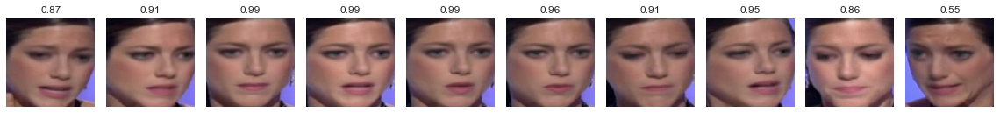

[Extracted 10 faces for file id40_id39_0007.mp4]
Label: fake
Fake prob: 0.6309245228767395


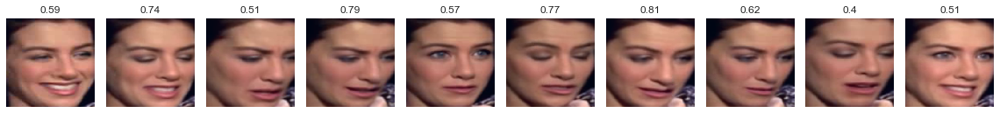

[Extracted 10 faces for file id40_id41_0004.mp4]
Label: fake
Fake prob: 0.5135934352874756


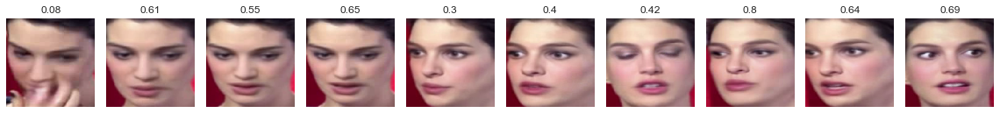

[Extracted 10 faces for file id40_id42_0001.mp4]
Label: fake
Fake prob: 0.828423798084259


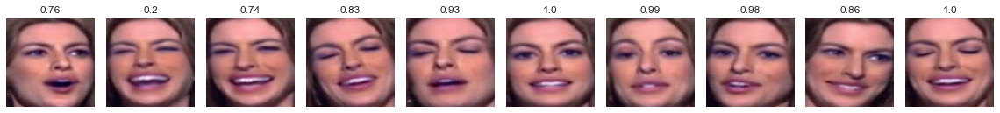

[Extracted 10 faces for file id40_id43_0009.mp4]
Label: fake
Fake prob: 0.8855438232421875


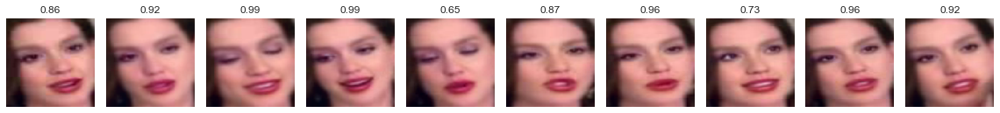

[Extracted 10 faces for file id40_id44_0000.mp4]
Label: fake
Fake prob: 0.6989993453025818


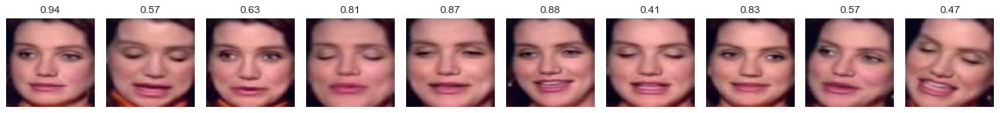

[Extracted 10 faces for file id40_id44_0009.mp4]
Label: fake
Fake prob: 0.6068596839904785


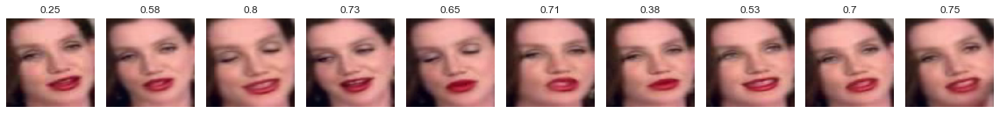

[Extracted 10 faces for file id40_id46_0003.mp4]
Label: fake
Fake prob: 0.7342063784599304


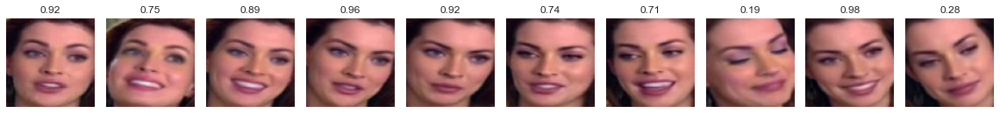

[Extracted 10 faces for file id40_id48_0002.mp4]
Label: fake
Fake prob: 0.9891023635864258


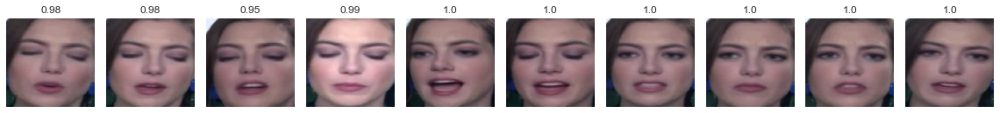

[Extracted 10 faces for file id41_id40_0000.mp4]
Label: fake
Fake prob: 0.45217129588127136


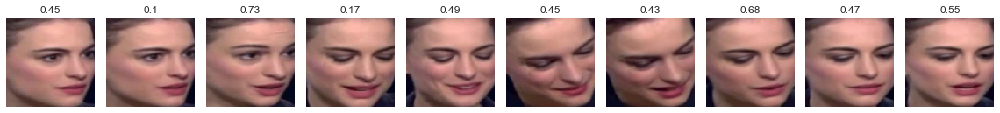

[Extracted 10 faces for file id41_id40_0005.mp4]
Label: fake
Fake prob: 0.8033855557441711


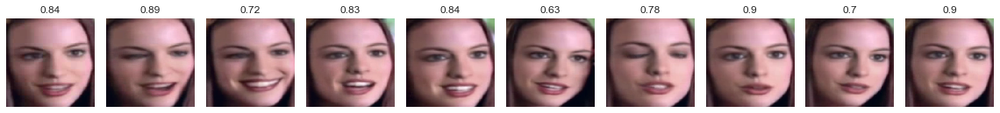

[Extracted 10 faces for file id41_id40_0007.mp4]
Label: fake
Fake prob: 0.8552708029747009


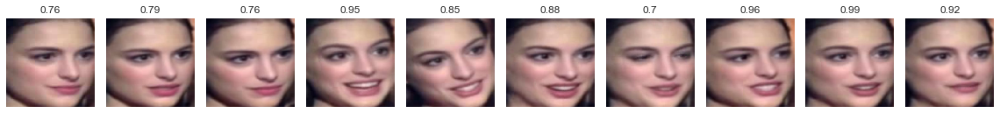

[Extracted 10 faces for file id41_id42_0002.mp4]
Label: fake
Fake prob: 0.8281845450401306


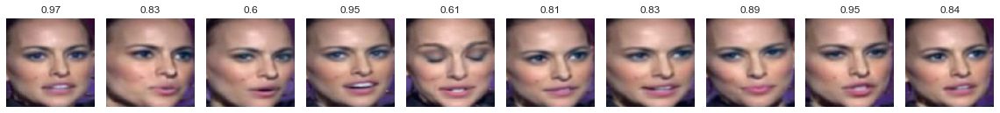

[Extracted 10 faces for file id41_id44_0001.mp4]
Label: fake
Fake prob: 0.5343145728111267


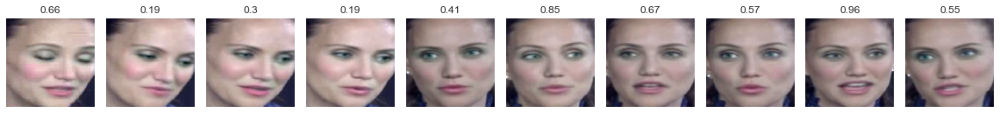

[Extracted 10 faces for file id41_id45_0000.mp4]
Label: fake
Fake prob: 0.6671274304389954


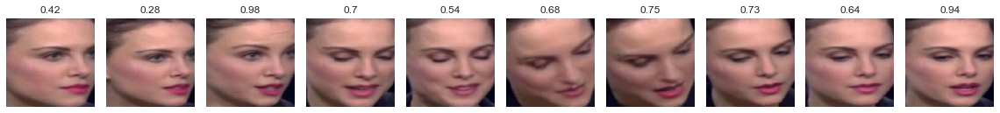

[Extracted 10 faces for file id41_id45_0008.mp4]
Label: fake
Fake prob: 0.5870529413223267


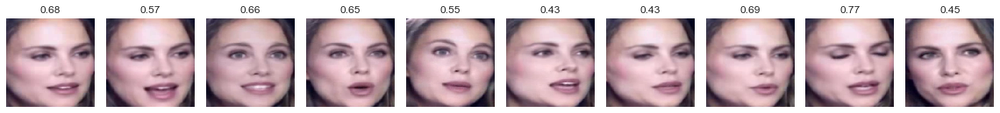

[Extracted 10 faces for file id41_id47_0007.mp4]
Label: fake
Fake prob: 0.9570603370666504


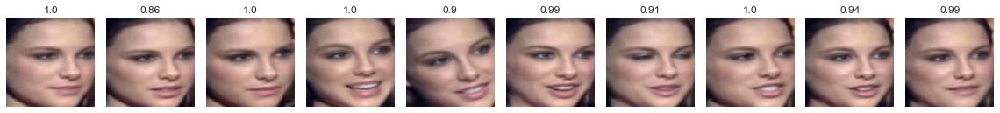

[Extracted 10 faces for file id41_id48_0003.mp4]
Label: fake
Fake prob: 0.9197125434875488


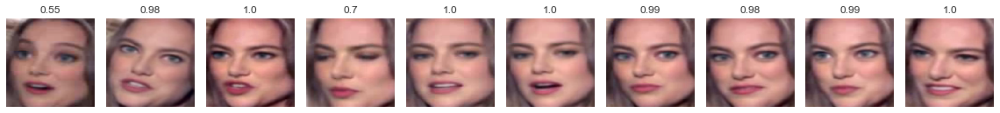

[Extracted 10 faces for file id41_id48_0004.mp4]
Label: fake
Fake prob: 0.864745557308197


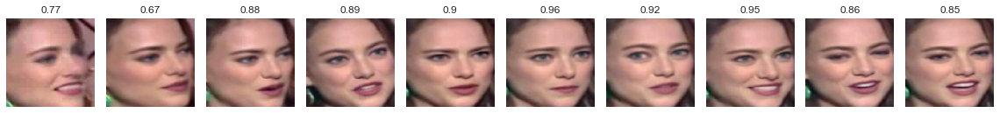

[Extracted 10 faces for file id42_id39_0003.mp4]
Label: fake
Fake prob: 0.7964243292808533


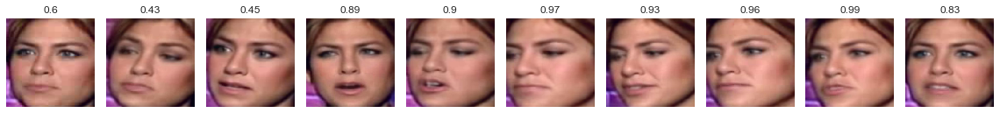

[Extracted 10 faces for file id42_id40_0002.mp4]
Label: fake
Fake prob: 0.9262761473655701


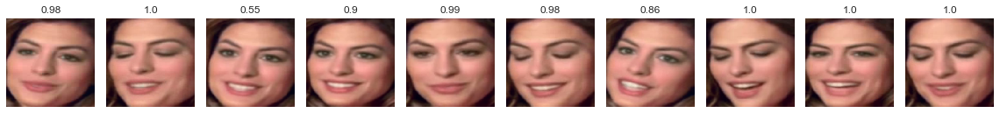

[Extracted 10 faces for file id42_id44_0000.mp4]
Label: fake
Fake prob: 0.9458643198013306


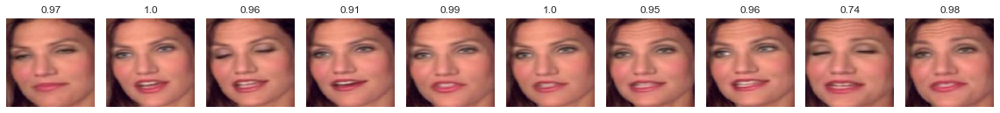

[Extracted 10 faces for file id42_id44_0003.mp4]
Label: fake
Fake prob: 0.6598039865493774


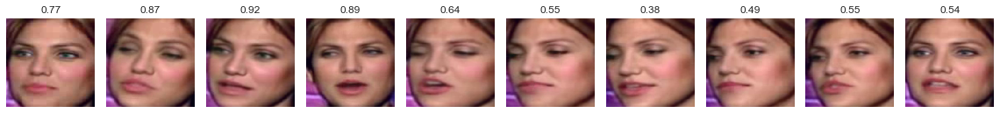

[Extracted 10 faces for file id42_id46_0000.mp4]
Label: fake
Fake prob: 0.9352594614028931


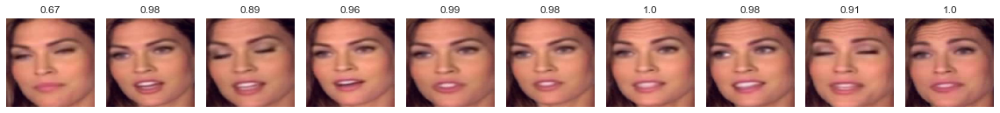

[Extracted 10 faces for file id43_id39_0008.mp4]
Label: fake
Fake prob: 0.8457018733024597


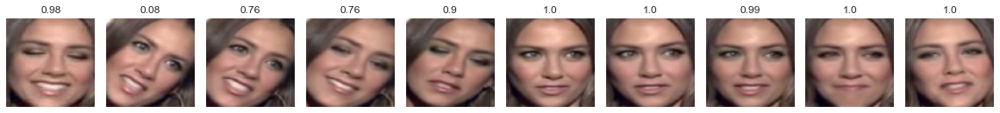

[Extracted 10 faces for file id43_id41_0003.mp4]
Label: fake
Fake prob: 0.8752045631408691


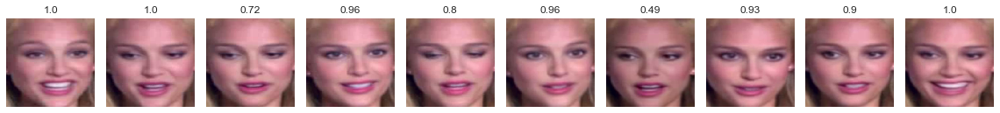

[Extracted 10 faces for file id43_id42_0006.mp4]
Label: fake
Fake prob: 0.9441862106323242


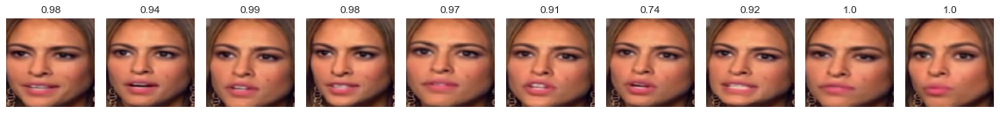

[Extracted 10 faces for file id43_id44_0007.mp4]
Label: fake
Fake prob: 0.26026561856269836


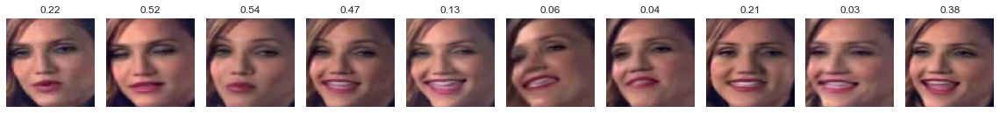

[Extracted 10 faces for file id43_id44_0009.mp4]
Label: fake
Fake prob: 0.7280144095420837


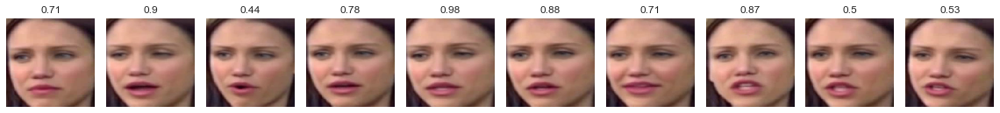

[Extracted 10 faces for file id43_id46_0000.mp4]
Label: fake
Fake prob: 0.9917897582054138


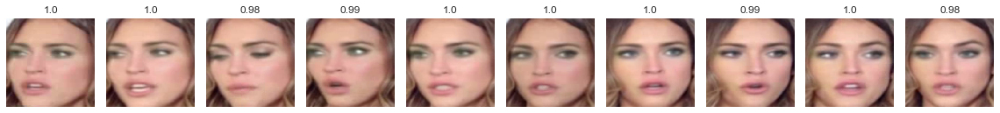

[Extracted 10 faces for file id43_id47_0003.mp4]
Label: fake
Fake prob: 0.8923563957214355


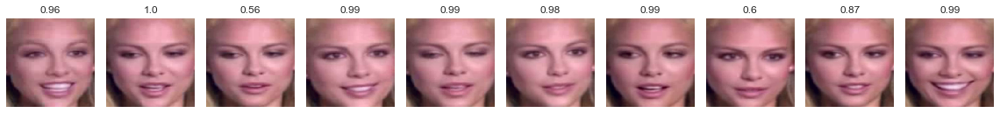

[Extracted 10 faces for file id44_id39_0004.mp4]
Label: fake
Fake prob: 0.9289354681968689


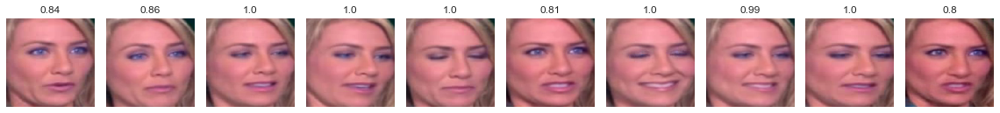

[Extracted 10 faces for file id44_id43_0003.mp4]
Label: fake
Fake prob: 0.32111939787864685


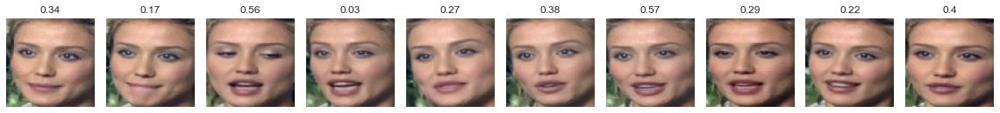

[Extracted 10 faces for file id44_id43_0005.mp4]
Label: fake
Fake prob: 0.5016354918479919


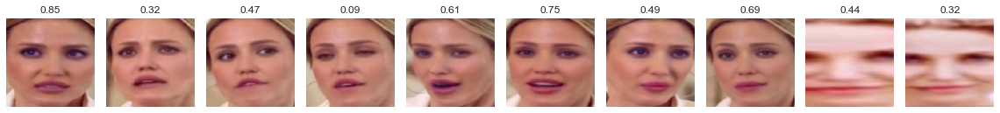

[Extracted 10 faces for file id44_id45_0003.mp4]
Label: fake
Fake prob: 0.547309398651123


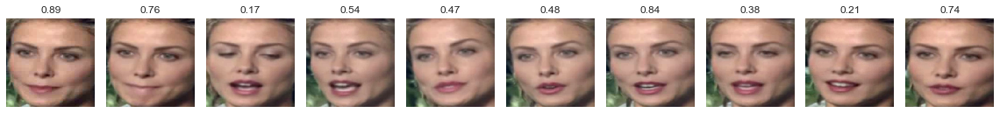

[Extracted 10 faces for file id45_id43_0003.mp4]
Label: fake
Fake prob: 0.4861420691013336


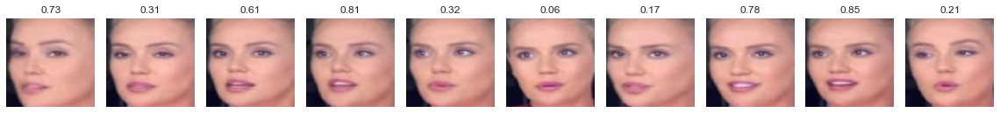

[Extracted 10 faces for file id45_id44_0005.mp4]
Label: fake
Fake prob: 0.871401309967041


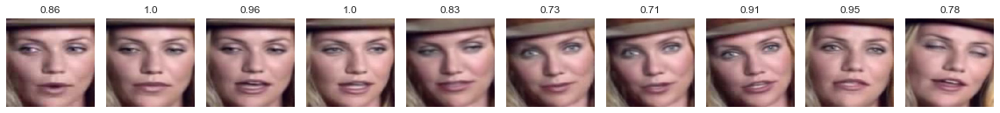

[Extracted 10 faces for file id45_id44_0009.mp4]
Label: fake
Fake prob: 0.9483880996704102


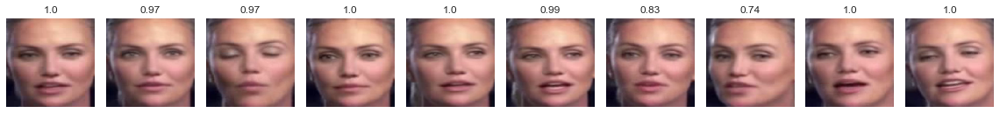

[Extracted 10 faces for file id45_id46_0002.mp4]
Label: fake
Fake prob: 0.5749144554138184


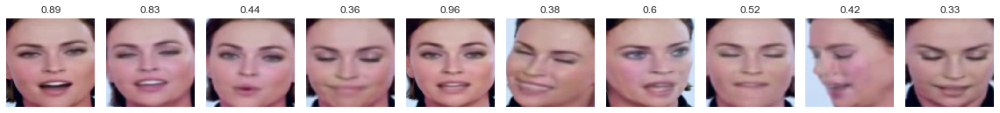

[Extracted 10 faces for file id45_id46_0003.mp4]
Label: fake
Fake prob: 0.6639079451560974


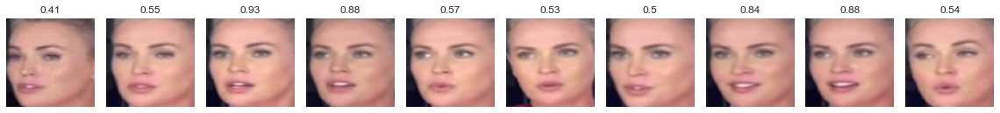

[Extracted 10 faces for file id45_id48_0003.mp4]
Label: fake
Fake prob: 0.9409001469612122


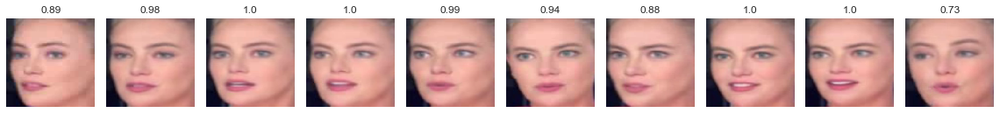

[Extracted 10 faces for file id45_id48_0009.mp4]
Label: fake
Fake prob: 0.9829592108726501


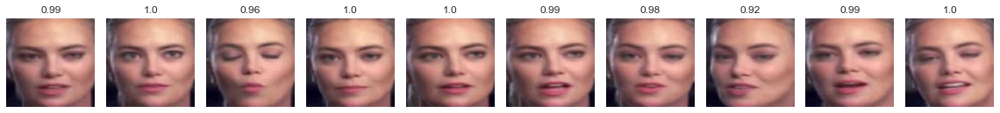

[Extracted 10 faces for file id46_id39_0004.mp4]
Label: fake
Fake prob: 0.8532560467720032


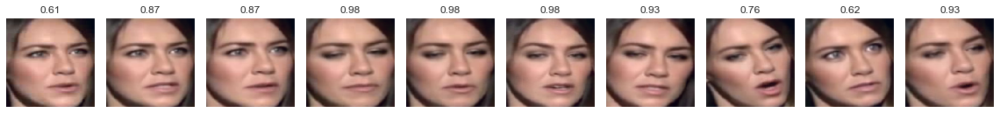

[Extracted 10 faces for file id46_id44_0001.mp4]
Label: fake
Fake prob: 0.9580619931221008


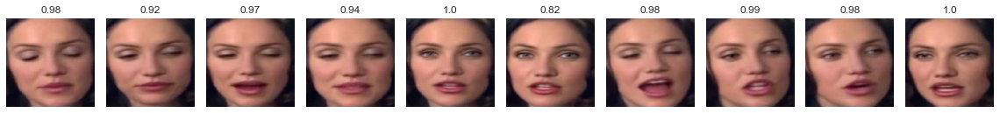

[Extracted 10 faces for file id46_id44_0007.mp4]
Label: fake
Fake prob: 0.7903473973274231


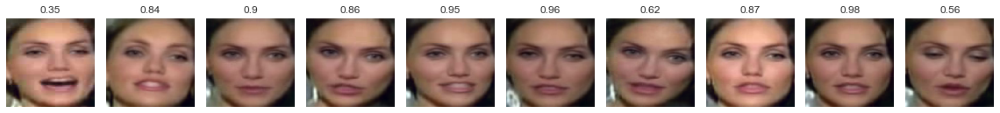

[Extracted 10 faces for file id46_id45_0008.mp4]
Label: fake
Fake prob: 0.9475317001342773


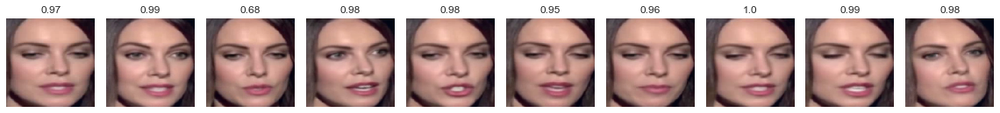

[Extracted 10 faces for file id46_id48_0002.mp4]
Label: fake
Fake prob: 0.9437462091445923


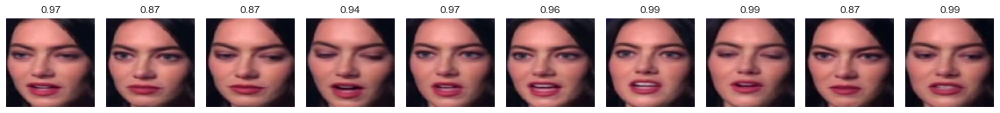

[Extracted 10 faces for file id47_id41_0002.mp4]
Label: fake
Fake prob: 0.5673439502716064


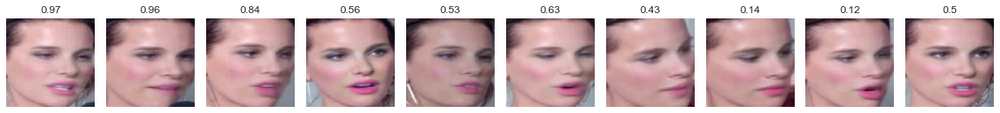

[Extracted 10 faces for file id47_id41_0008.mp4]
Label: fake
Fake prob: 0.7402086853981018


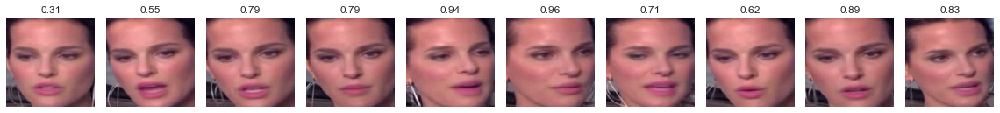

[Extracted 10 faces for file id47_id42_0000.mp4]
Label: fake
Fake prob: 0.8141018748283386


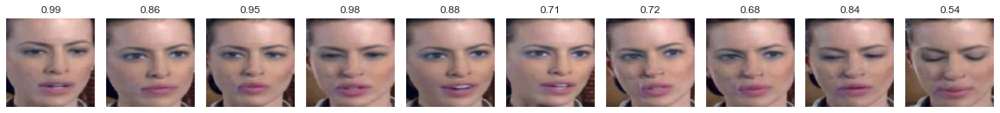

[Extracted 10 faces for file id47_id42_0008.mp4]
Label: fake
Fake prob: 0.6022629141807556


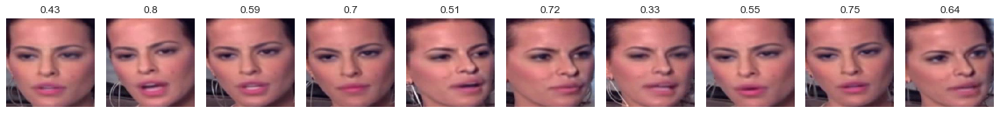

[Extracted 10 faces for file id47_id43_0007.mp4]
Label: fake
Fake prob: 0.9215837717056274


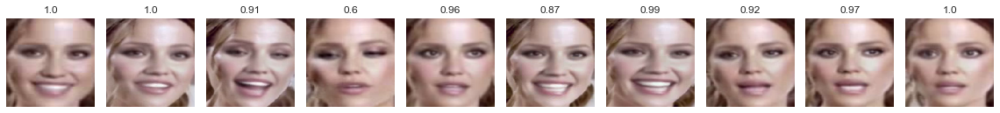

[Extracted 10 faces for file id47_id43_0009.mp4]
Label: fake
Fake prob: 0.7793790698051453


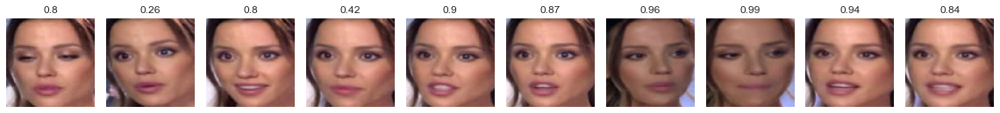

[Extracted 10 faces for file id47_id44_0005.mp4]
Label: fake
Fake prob: 0.4812493920326233


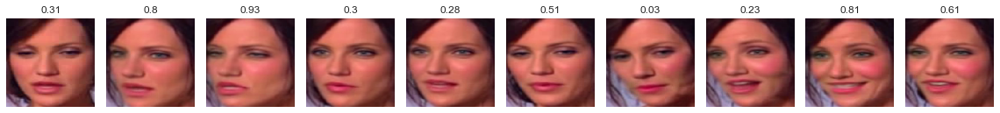

[Extracted 10 faces for file id47_id44_0007.mp4]
Label: fake
Fake prob: 0.8968548774719238


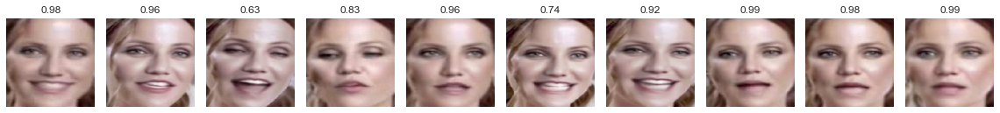

[Extracted 10 faces for file id47_id46_0004.mp4]
Label: fake
Fake prob: 0.47693148255348206


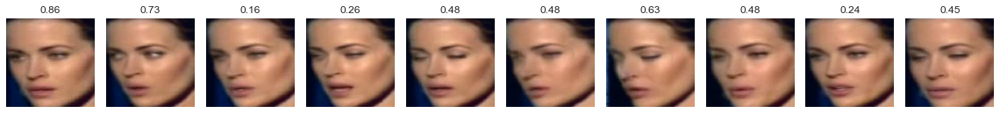

[Extracted 10 faces for file id47_id46_0008.mp4]
Label: fake
Fake prob: 0.5560106039047241


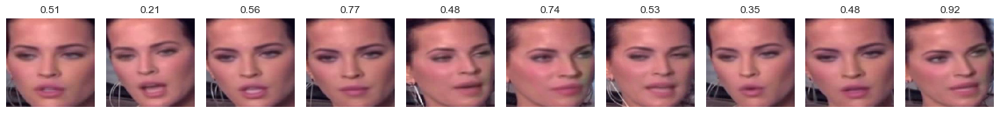

[Extracted 10 faces for file id47_id46_0009.mp4]
Label: fake
Fake prob: 0.8266502618789673


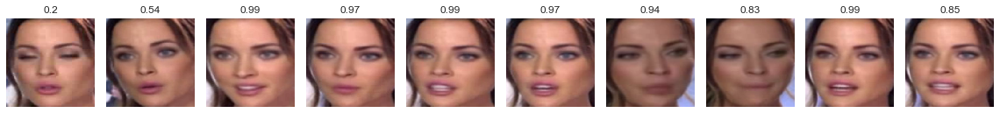

[Extracted 10 faces for file id48_id39_0006.mp4]
Label: fake
Fake prob: 0.826821506023407


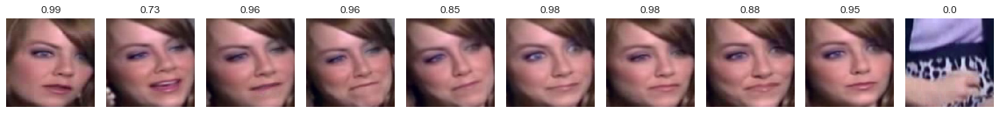

[Extracted 10 faces for file id48_id41_0001.mp4]
Label: fake
Fake prob: 0.9612700343132019


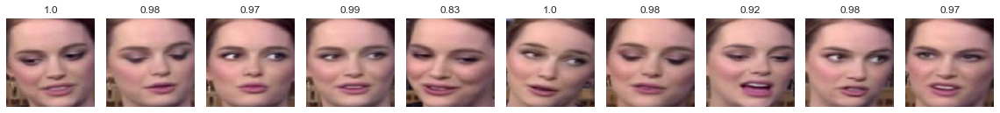

[Extracted 10 faces for file id48_id44_0001.mp4]
Label: fake
Fake prob: 0.9351646304130554


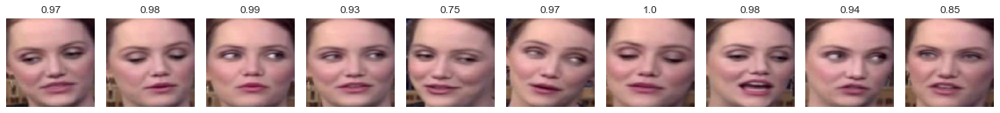

[Extracted 10 faces for file id48_id45_0003.mp4]
Label: fake
Fake prob: 0.43616151809692383


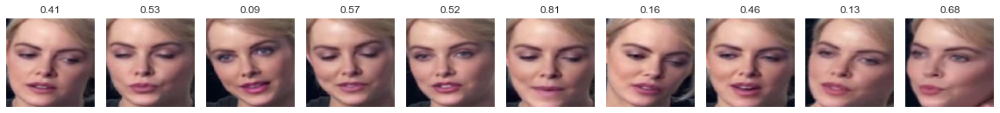

[Extracted 10 faces for file id49_id50_0001.mp4]
Label: fake
Fake prob: 0.9899362921714783


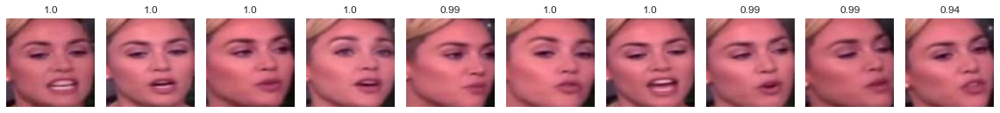

[Extracted 10 faces for file id49_id51_0001.mp4]
Label: fake
Fake prob: 0.9658073782920837


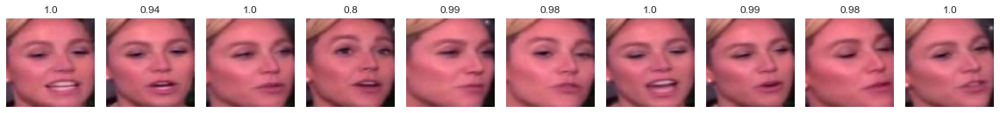

[Extracted 10 faces for file id49_id52_0004.mp4]
Label: fake
Fake prob: 0.6634873747825623


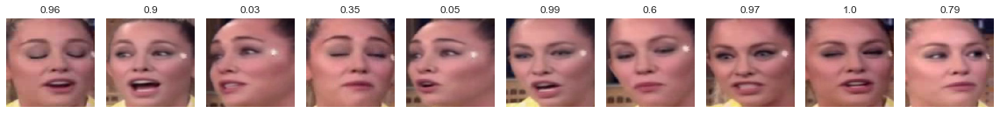

[Extracted 10 faces for file id49_id53_0005.mp4]
Label: fake
Fake prob: 0.9611366391181946


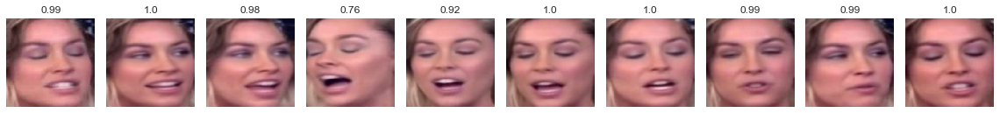

[Extracted 10 faces for file id49_id55_0009.mp4]
Label: fake
Fake prob: 0.92611163854599


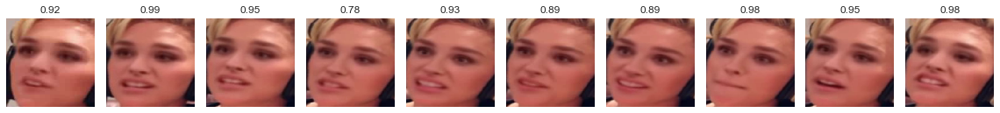

[Extracted 10 faces for file id49_id56_0007.mp4]
Label: fake
Fake prob: 0.7833582758903503


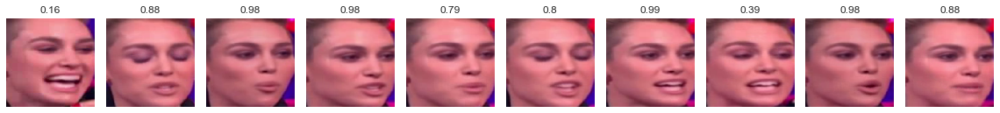

[Extracted 10 faces for file id49_id57_0005.mp4]
Label: fake
Fake prob: 0.8876523971557617


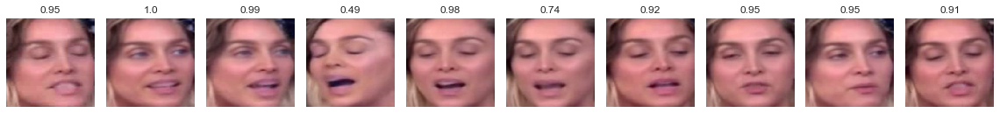

[Extracted 10 faces for file id49_id58_0008.mp4]
Label: fake
Fake prob: 0.9072551727294922


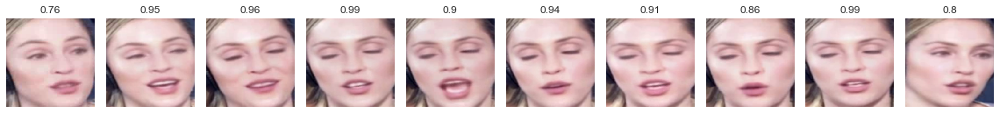

[Extracted 10 faces for file id50_id49_0002.mp4]
Label: fake
Fake prob: 0.976841390132904


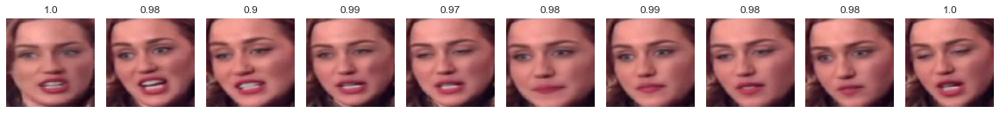

[Extracted 10 faces for file id50_id49_0003.mp4]
Label: fake
Fake prob: 0.7924678921699524


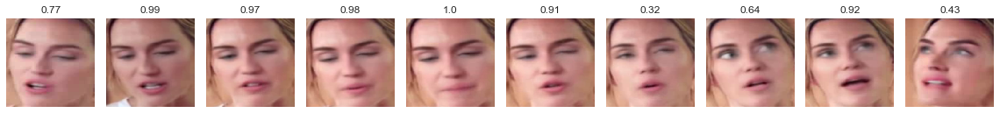

[Extracted 10 faces for file id50_id49_0007.mp4]
Label: fake
Fake prob: 0.9651350378990173


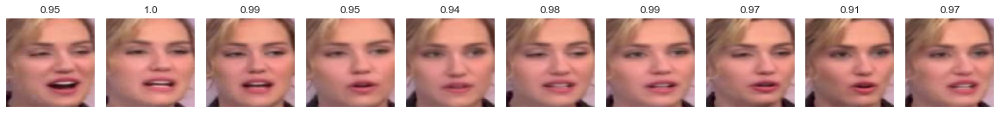

[Extracted 10 faces for file id50_id54_0000.mp4]
Label: fake
Fake prob: 0.6311973333358765


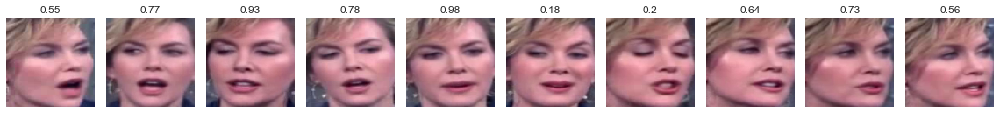

[Extracted 10 faces for file id50_id54_0005.mp4]
Label: fake
Fake prob: 0.6223692893981934


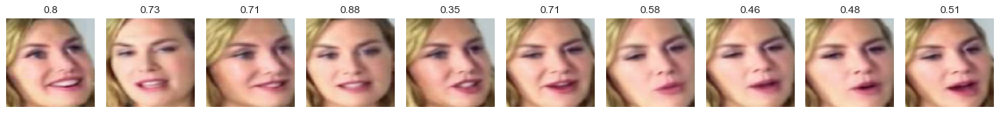

[Extracted 10 faces for file id59_id5_0000.mp4]
Label: fake
Fake prob: 0.4499163329601288


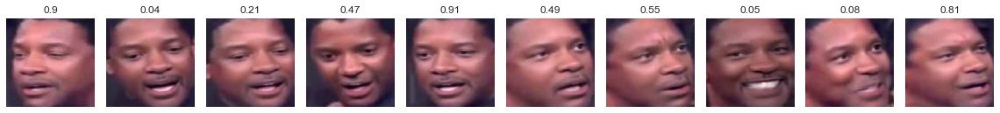

[Extracted 10 faces for file id59_id5_0007.mp4]
Label: fake
Fake prob: 0.4519607126712799


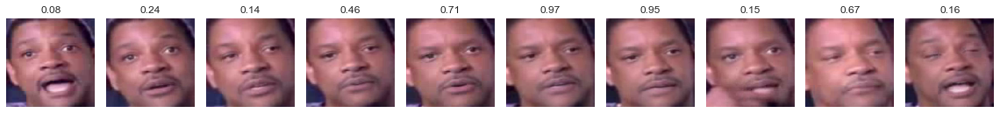

[Extracted 10 faces for file id59_id60_0005.mp4]
Label: fake
Fake prob: 0.3802703320980072


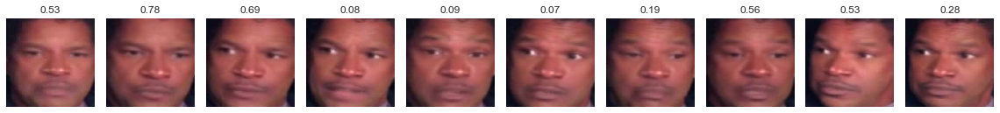

[Extracted 10 faces for file id60_id59_0004.mp4]
Label: fake
Fake prob: 0.6226677298545837


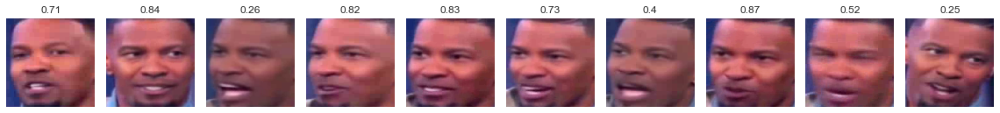

[Extracted 10 faces for file id60_id61_0002.mp4]
Label: fake
Fake prob: 0.25457528233528137


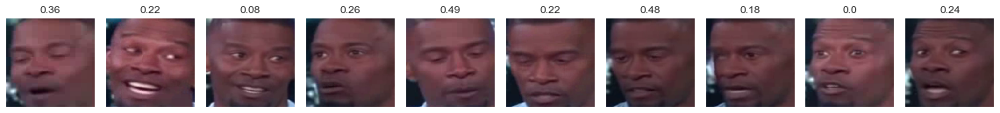

[Extracted 10 faces for file id60_id61_0009.mp4]
Label: fake
Fake prob: 0.5871769785881042


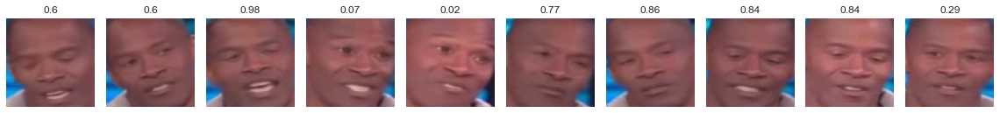

[Extracted 10 faces for file id61_id59_0006.mp4]
Label: fake
Fake prob: 0.7744104266166687


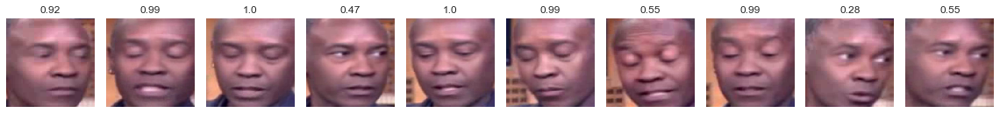

[Extracted 10 faces for file id61_id5_0000.mp4]
Label: fake
Fake prob: 0.4413691461086273


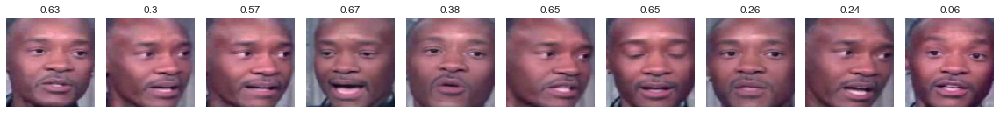

[Extracted 10 faces for file id61_id5_0009.mp4]
Label: fake
Fake prob: 0.3374267816543579


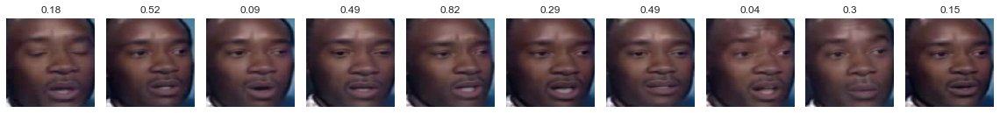

[Extracted 10 faces for file 00016.mp4]
Label: real
Fake prob: 0.09275390207767487


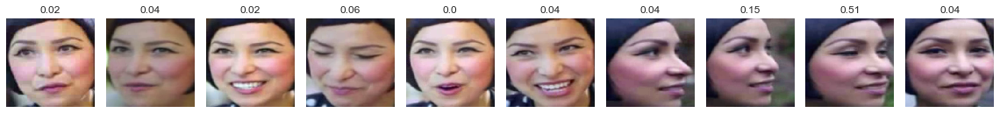

[Extracted 10 faces for file 00034.mp4]
Label: real
Fake prob: 0.11719918251037598


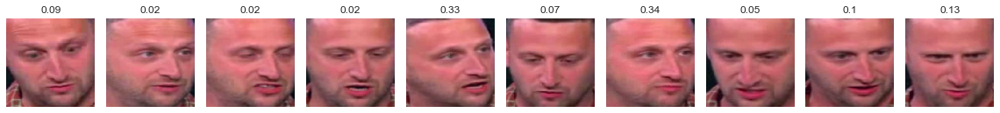

[Extracted 10 faces for file 00037.mp4]
Label: real
Fake prob: 0.007389289326965809


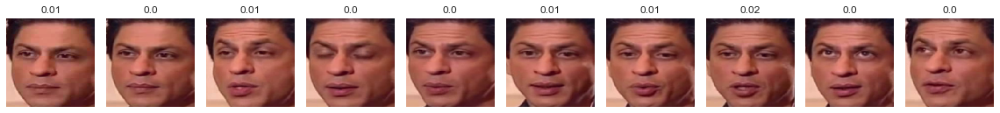

[Extracted 10 faces for file 00040.mp4]
Label: real
Fake prob: 0.00503169372677803


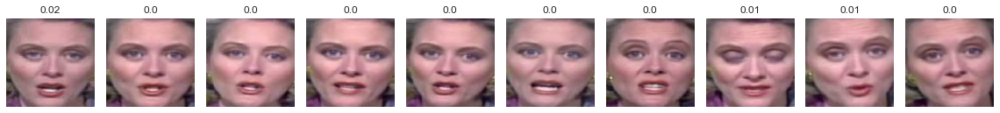

[Extracted 10 faces for file 00059.mp4]
Label: real
Fake prob: 0.0017054424388334155


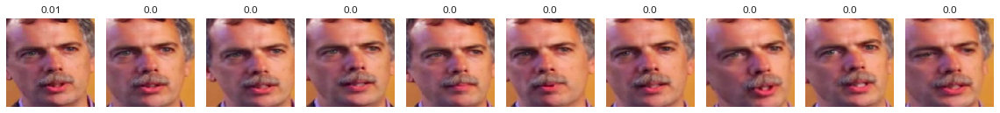

[Extracted 10 faces for file 00071.mp4]
Label: real
Fake prob: 0.5681992173194885


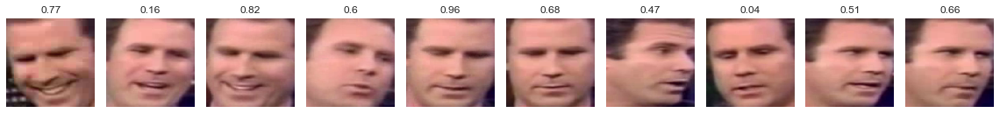

[Extracted 10 faces for file 00077.mp4]
Label: real
Fake prob: 0.0012398789403960109


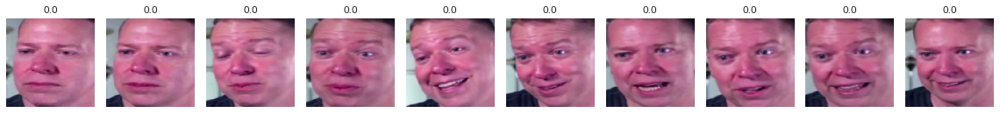

[Extracted 10 faces for file 00083.mp4]
Label: real
Fake prob: 0.02764313481748104


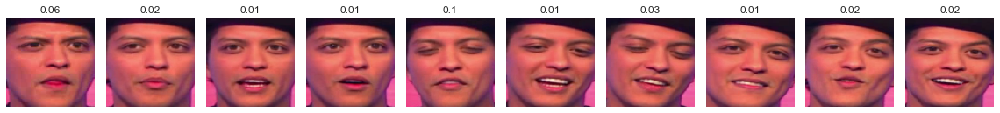

[Extracted 10 faces for file 00094.mp4]
Label: real
Fake prob: 0.0029795838054269552


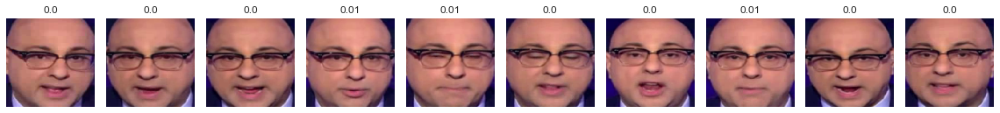

[Extracted 10 faces for file 00106.mp4]
Label: real
Fake prob: 0.007514201104640961


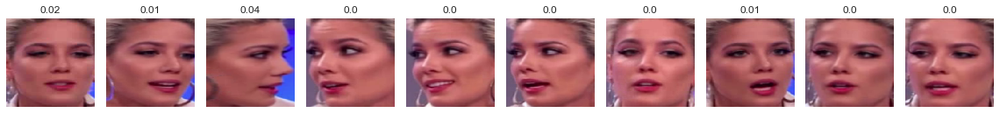

[Extracted 10 faces for file 00119.mp4]
Label: real
Fake prob: 0.017918528988957405


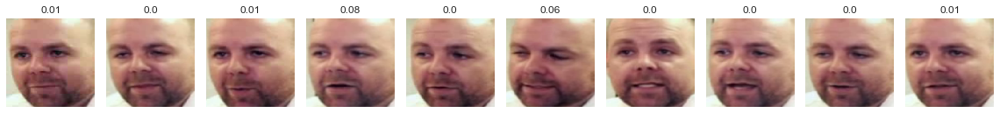

[Extracted 10 faces for file 00147.mp4]
Label: real
Fake prob: 0.23422358930110931


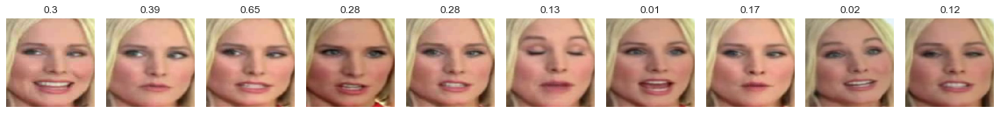

[Extracted 10 faces for file 00166.mp4]
Label: real
Fake prob: 0.016216883435845375


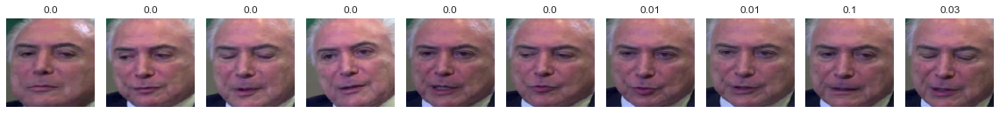

[Extracted 10 faces for file 00170.mp4]
Label: real
Fake prob: 0.03298816829919815


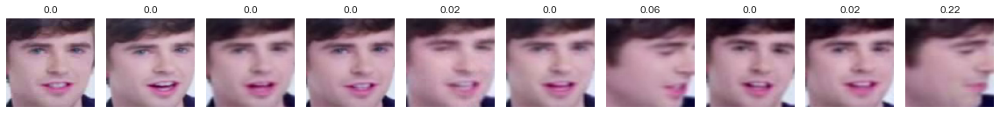

[Extracted 10 faces for file 00177.mp4]
Label: real
Fake prob: 0.01901504211127758


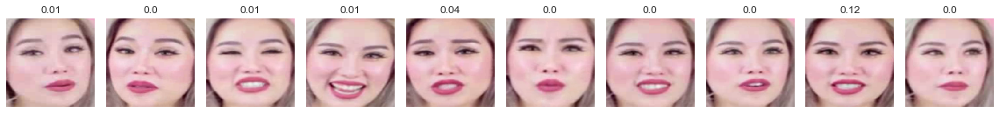

[Extracted 10 faces for file 00191.mp4]
Label: real
Fake prob: 0.00010495432798052207


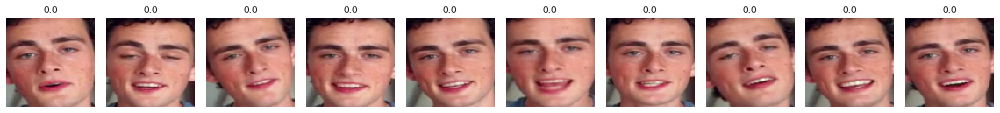

[Extracted 10 faces for file 00194.mp4]
Label: real
Fake prob: 0.048730481415987015


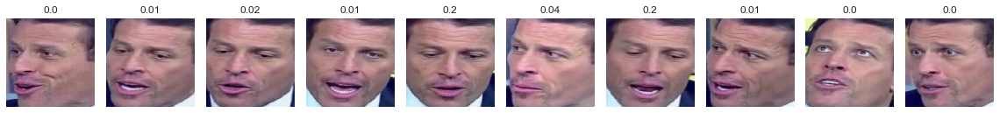

[Extracted 10 faces for file 00216.mp4]
Label: real
Fake prob: 0.0738103985786438


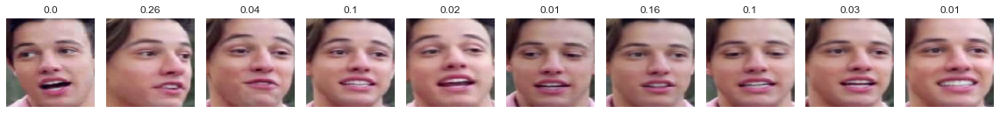

[Extracted 10 faces for file 00218.mp4]
Label: real
Fake prob: 0.0034029807429760695


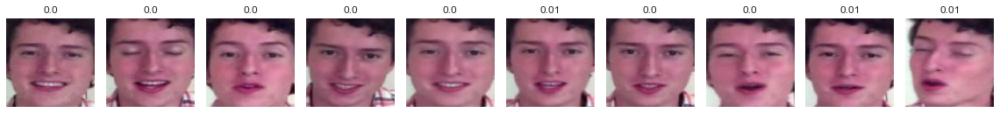

[Extracted 10 faces for file 00240.mp4]
Label: real
Fake prob: 0.0438610278069973


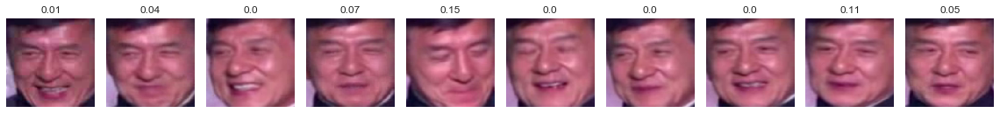

[Extracted 10 faces for file 00282.mp4]
Label: real
Fake prob: 0.10091417282819748


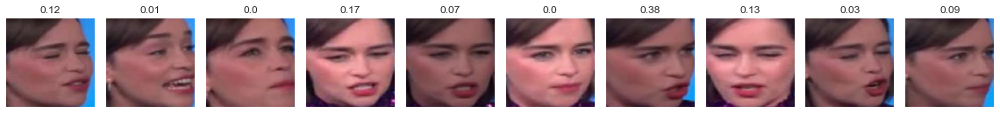

[Extracted 10 faces for file id0_0004.mp4]
Label: real
Fake prob: 0.08144713938236237


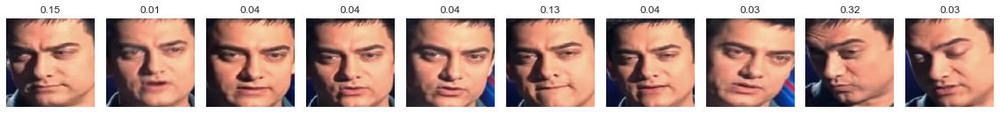

[Extracted 10 faces for file id0_0006.mp4]
Label: real
Fake prob: 0.09638778865337372


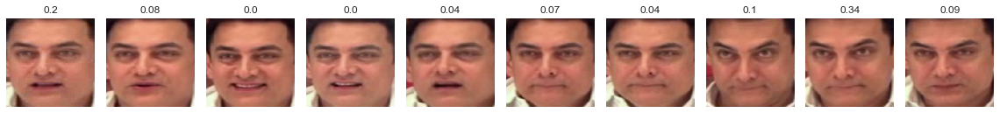

[Extracted 10 faces for file id10_0004.mp4]
Label: real
Fake prob: 0.05225154384970665


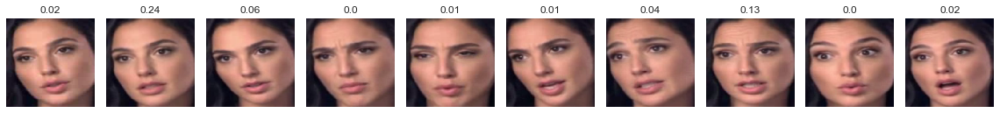

[Extracted 10 faces for file id11_0005.mp4]
Label: real
Fake prob: 0.004645026754587889


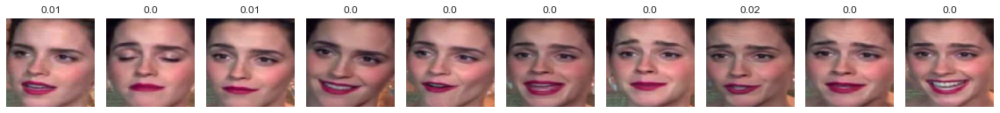

[Extracted 10 faces for file id12_0001.mp4]
Label: real
Fake prob: 0.149042010307312


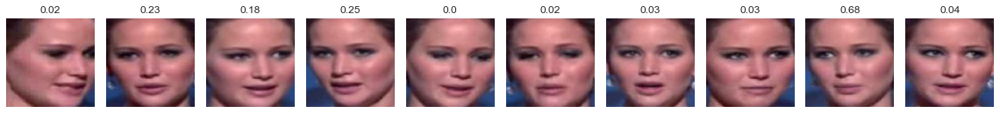

[Extracted 10 faces for file id13_0006.mp4]
Label: real
Fake prob: 0.08064330369234085


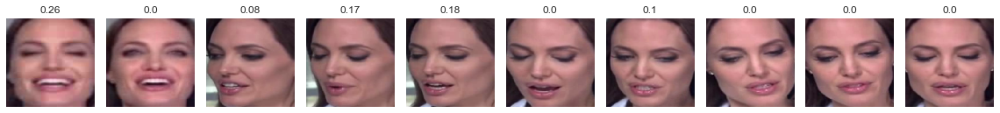

[Extracted 10 faces for file id13_0011.mp4]
Label: real
Fake prob: 0.004128755535930395


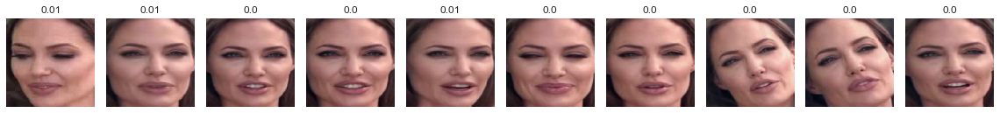

[Extracted 10 faces for file id13_0015.mp4]
Label: real
Fake prob: 0.01826775260269642


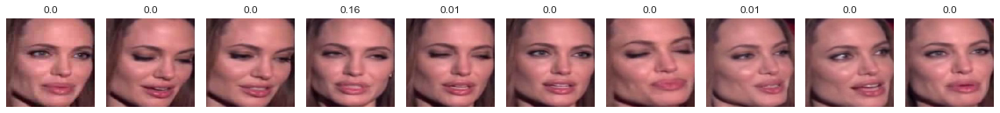

[Extracted 10 faces for file id16_0011.mp4]
Label: real
Fake prob: 0.4128388464450836


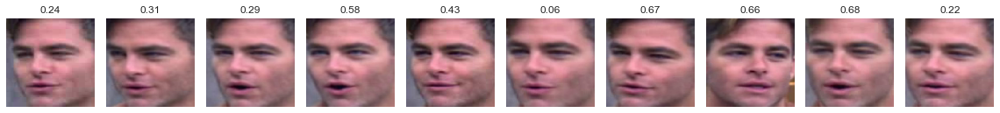

[Extracted 10 faces for file id17_0001.mp4]
Label: real
Fake prob: 0.2209191769361496


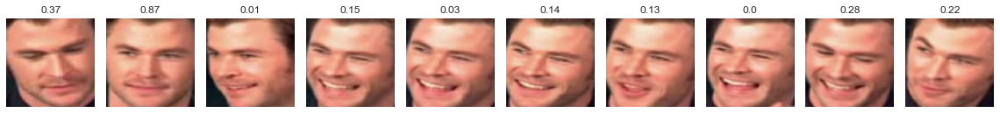

[Extracted 10 faces for file id17_0003.mp4]
Label: real
Fake prob: 0.7039787769317627


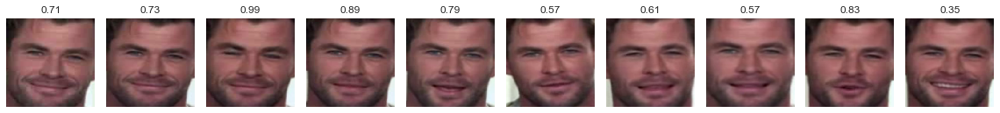

[Extracted 10 faces for file id20_0002.mp4]
Label: real
Fake prob: 0.20530875027179718


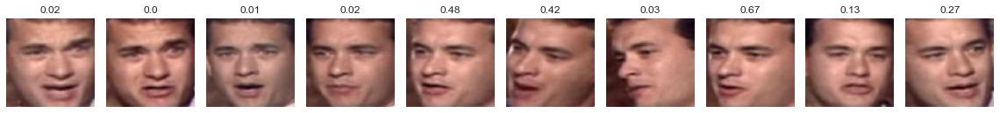

[Extracted 10 faces for file id20_0003.mp4]
Label: real
Fake prob: 0.08324150741100311


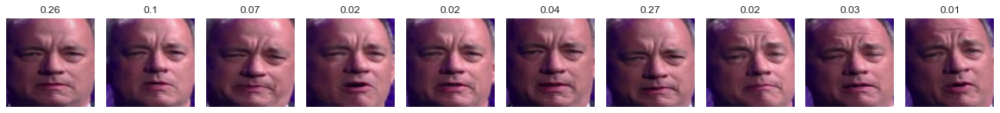

[Extracted 10 faces for file id20_0005.mp4]
Label: real
Fake prob: 0.02343478798866272


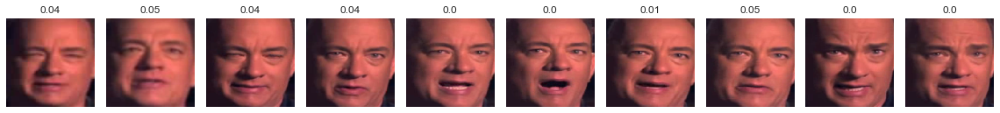

[Extracted 10 faces for file id21_0004.mp4]
Label: real
Fake prob: 0.2538919150829315


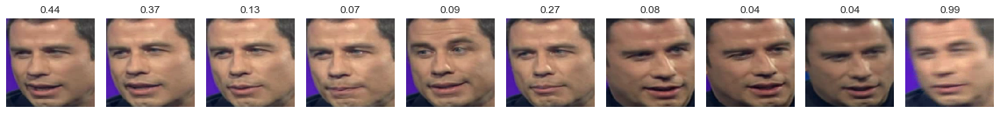

[Extracted 10 faces for file id22_0000.mp4]
Label: real
Fake prob: 0.0015500885201618075


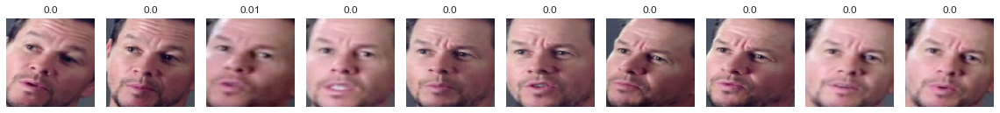

[Extracted 10 faces for file id22_0004.mp4]
Label: real
Fake prob: 0.2932681143283844


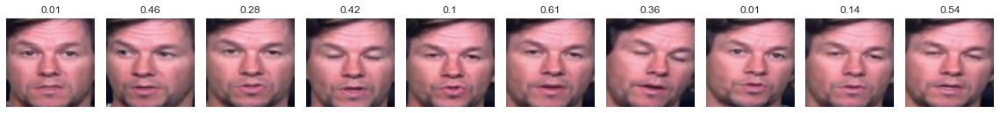

[Extracted 10 faces for file id24_0000.mp4]
Label: real
Fake prob: 0.4728834629058838


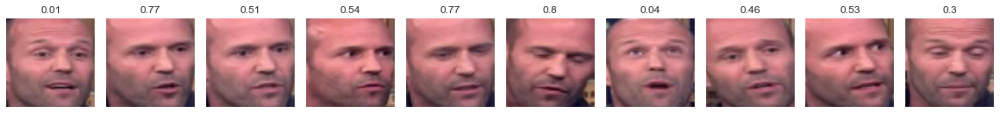

[Extracted 10 faces for file id24_0004.mp4]
Label: real
Fake prob: 0.2667575478553772


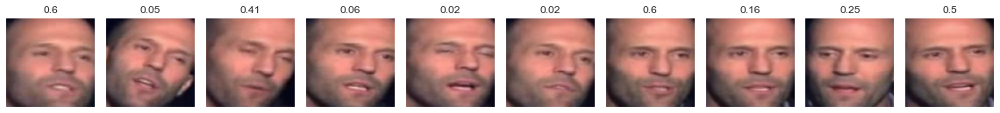

[Extracted 10 faces for file id25_0001.mp4]
Label: real
Fake prob: 0.054546333849430084


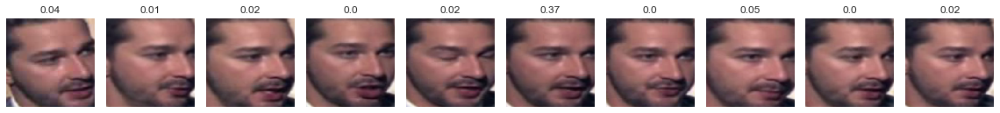

[Extracted 10 faces for file id25_0010.mp4]
Label: real
Fake prob: 0.04599940776824951


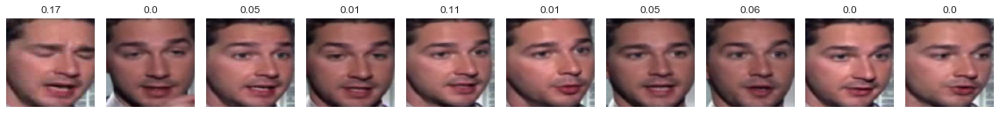

[Extracted 10 faces for file id26_0001.mp4]
Label: real
Fake prob: 0.07813874632120132


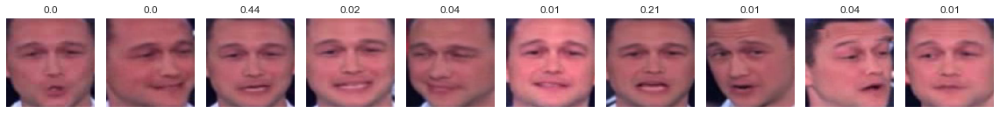

[Extracted 10 faces for file id26_0005.mp4]
Label: real
Fake prob: 0.025488287210464478


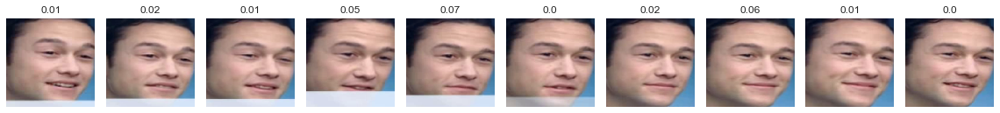

[Extracted 10 faces for file id27_0000.mp4]
Label: real
Fake prob: 0.16922664642333984


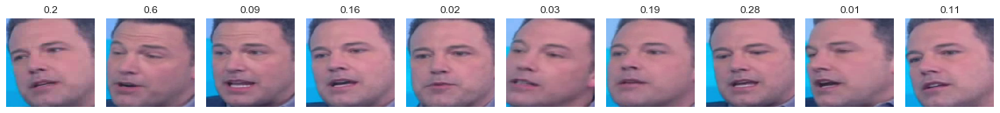

[Extracted 10 faces for file id29_0007.mp4]
Label: real
Fake prob: 0.18894045054912567


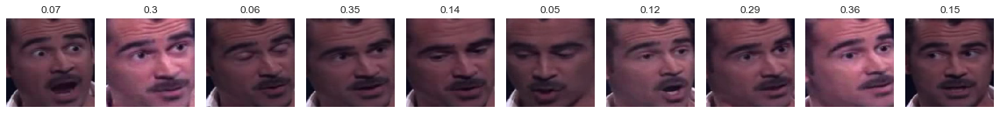

[Extracted 10 faces for file id2_0004.mp4]
Label: real
Fake prob: 0.1768227070569992


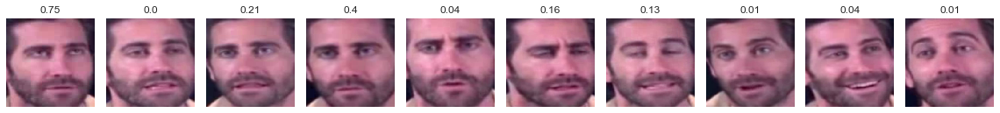

[Extracted 10 faces for file id2_0006.mp4]
Label: real
Fake prob: 0.3307747542858124


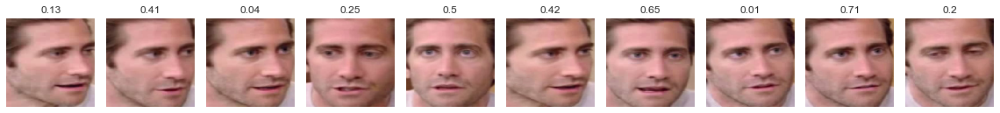

[Extracted 10 faces for file id30_0004.mp4]
Label: real
Fake prob: 0.208942249417305


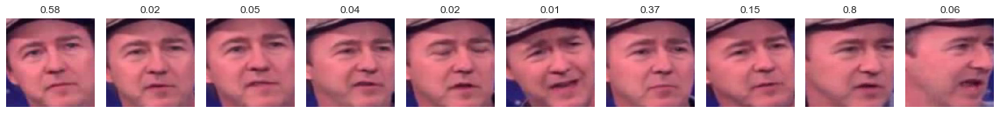

[Extracted 10 faces for file id30_0005.mp4]
Label: real
Fake prob: 0.19853775203227997


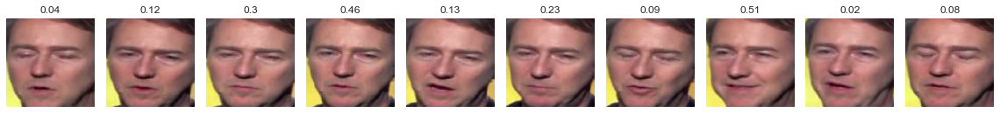

[Extracted 10 faces for file id30_0007.mp4]
Label: real
Fake prob: 0.03407865762710571


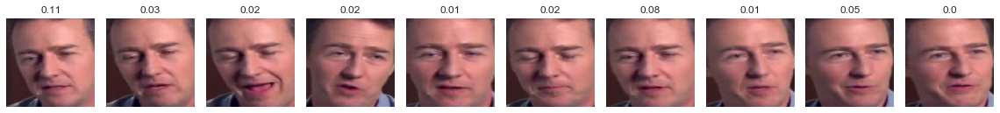

[Extracted 10 faces for file id32_0004.mp4]
Label: real
Fake prob: 0.03902159258723259


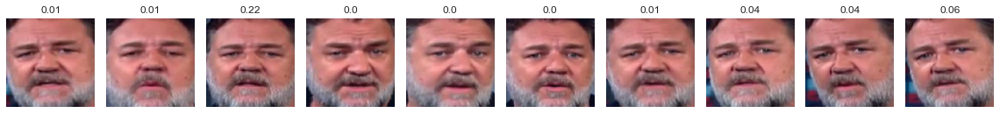

[Extracted 10 faces for file id33_0003.mp4]
Label: real
Fake prob: 0.1378476321697235


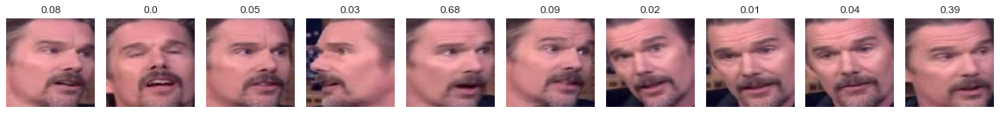

[Extracted 10 faces for file id34_0005.mp4]
Label: real
Fake prob: 0.008235721848905087


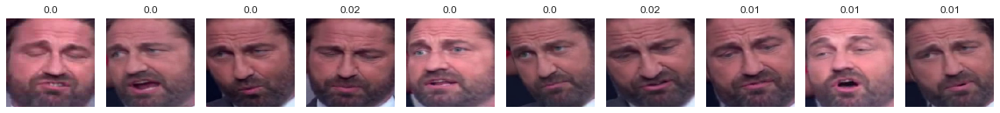

[Extracted 10 faces for file id35_0008.mp4]
Label: real
Fake prob: 0.010531962849199772


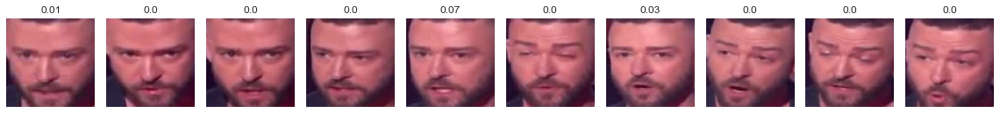

[Extracted 10 faces for file id37_0002.mp4]
Label: real
Fake prob: 0.016921794041991234


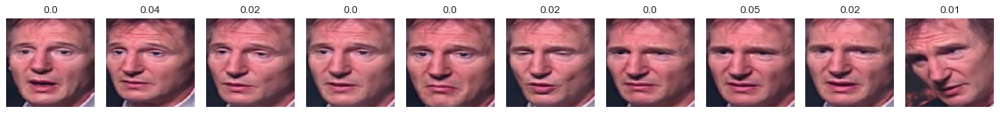

[Extracted 10 faces for file id37_0003.mp4]
Label: real
Fake prob: 0.06771369278430939


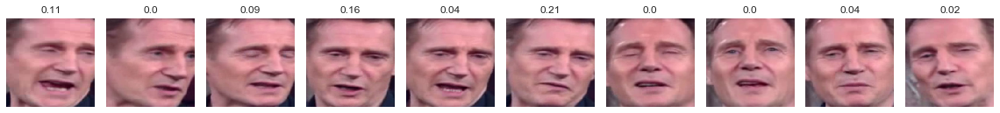

[Extracted 10 faces for file id38_0002.mp4]
Label: real
Fake prob: 0.038336437195539474


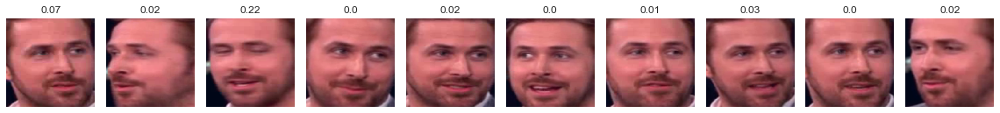

[Extracted 10 faces for file id39_0002.mp4]
Label: real
Fake prob: 0.042344871908426285


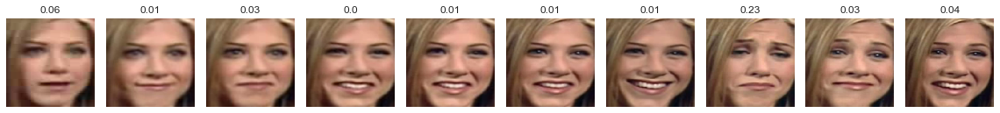

[Extracted 10 faces for file id3_0001.mp4]
Label: real
Fake prob: 0.006241425406187773


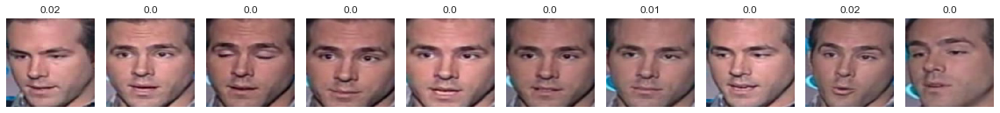

[Extracted 10 faces for file id3_0002.mp4]
Label: real
Fake prob: 0.010946941561996937


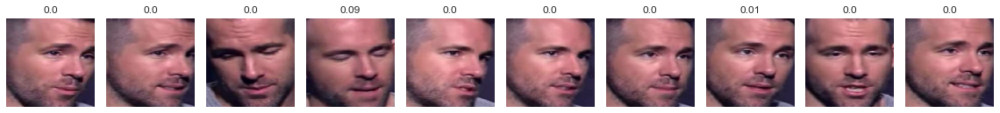

[Extracted 10 faces for file id3_0007.mp4]
Label: real
Fake prob: 0.20598642528057098


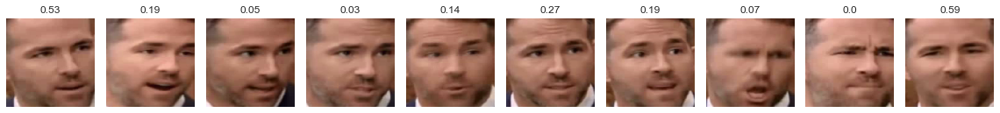

[Extracted 10 faces for file id40_0007.mp4]
Label: real
Fake prob: 0.05470597743988037


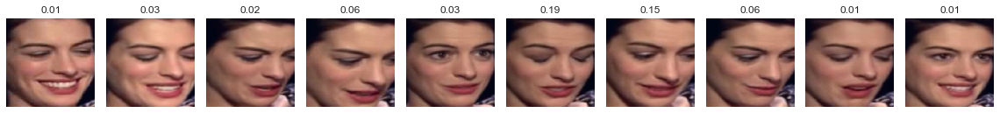

[Extracted 10 faces for file id41_0008.mp4]
Label: real
Fake prob: 0.008436177857220173


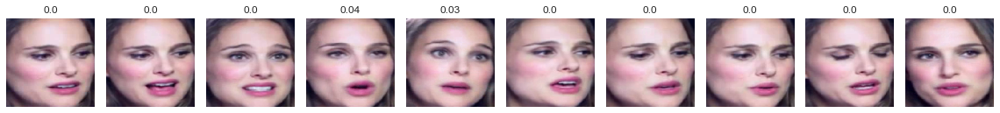

[Extracted 10 faces for file id43_0004.mp4]
Label: real
Fake prob: 0.18504425883293152


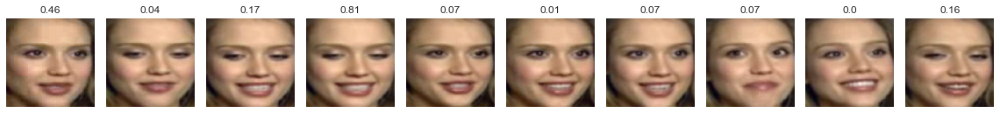

[Extracted 10 faces for file id43_0008.mp4]
Label: real
Fake prob: 0.20977787673473358


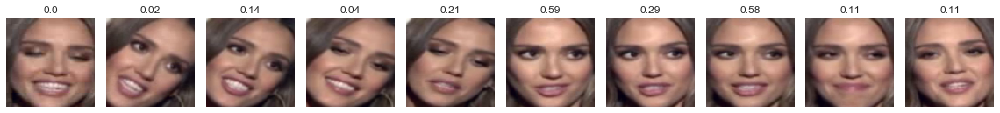

[Extracted 10 faces for file id45_0006.mp4]
Label: real
Fake prob: 0.1312759816646576


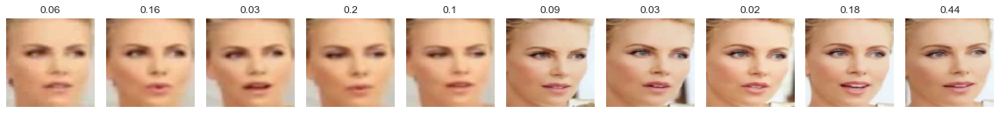

[Extracted 10 faces for file id47_0007.mp4]
Label: real
Fake prob: 0.29183414578437805


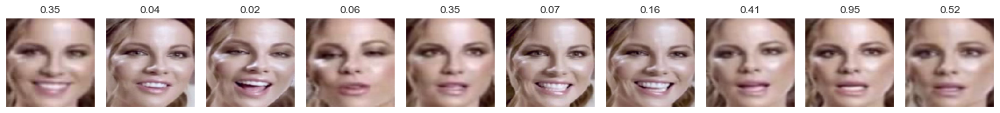

[Extracted 10 faces for file id51_0000.mp4]
Label: real
Fake prob: 0.11171835660934448


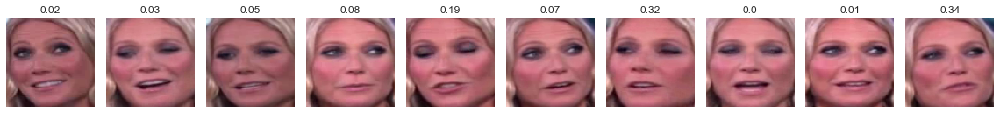

[Extracted 10 faces for file id51_0004.mp4]
Label: real
Fake prob: 0.039753541350364685


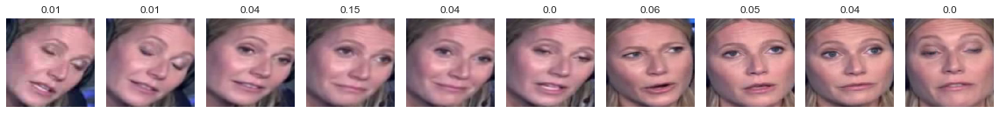

[Extracted 10 faces for file id51_0008.mp4]
Label: real
Fake prob: 0.030692001804709435


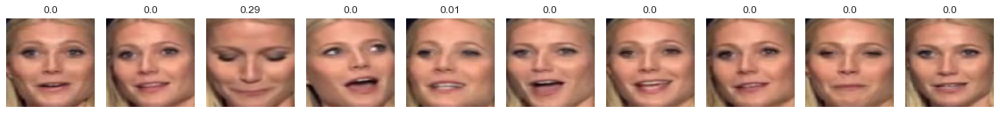

[Extracted 10 faces for file id53_0002.mp4]
Label: real
Fake prob: 0.03243832290172577


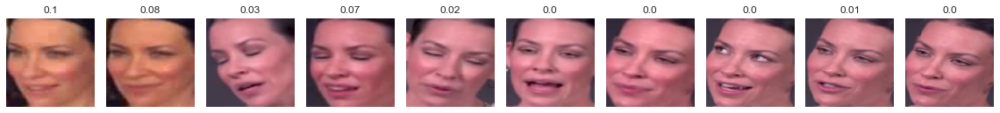

[Extracted 10 faces for file id54_0009.mp4]
Label: real
Fake prob: 0.041934218257665634


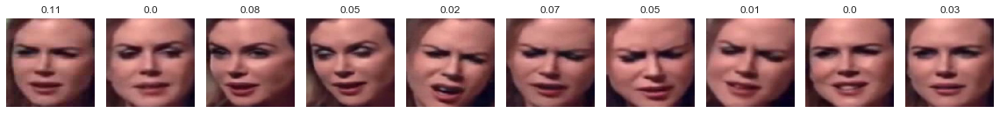

[Extracted 10 faces for file id55_0008.mp4]
Label: real
Fake prob: 0.02028546668589115


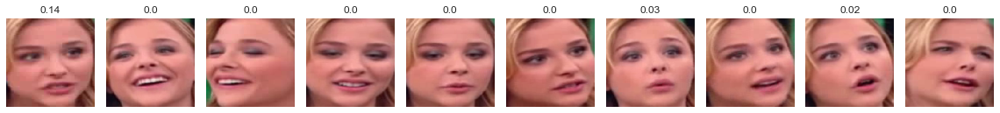

[Extracted 10 faces for file id57_0002.mp4]
Label: real
Fake prob: 0.13973939418792725


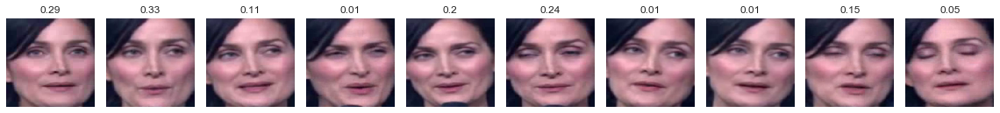

[Extracted 10 faces for file id59_0005.mp4]
Label: real
Fake prob: 0.0482293926179409


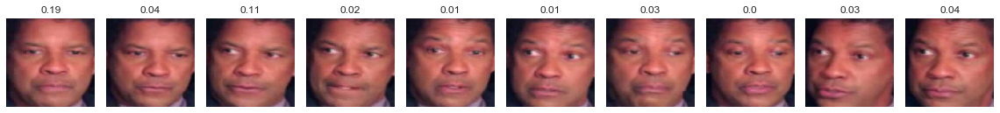

[Extracted 10 faces for file id61_0008.mp4]
Label: real
Fake prob: 0.025263754650950432


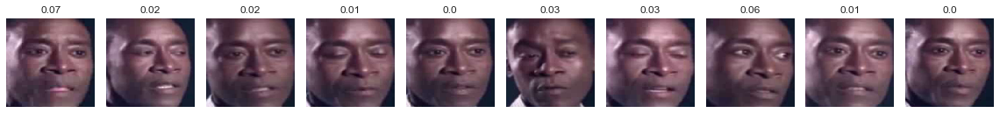

[Extracted 10 faces for file id6_0009.mp4]
Label: real
Fake prob: 0.0951022282242775


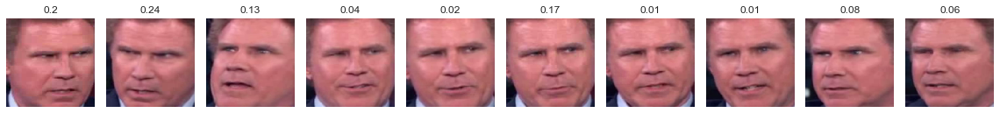

[Extracted 10 faces for file id8_0002.mp4]
Label: real
Fake prob: 0.009419343434274197


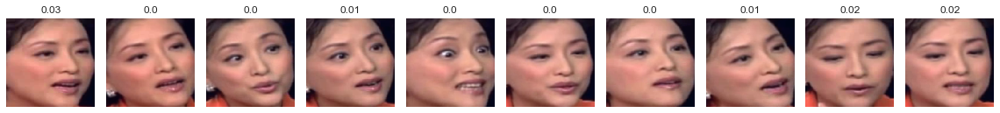

[Extracted 10 faces for file id8_0009.mp4]
Label: real
Fake prob: 0.006549605168402195


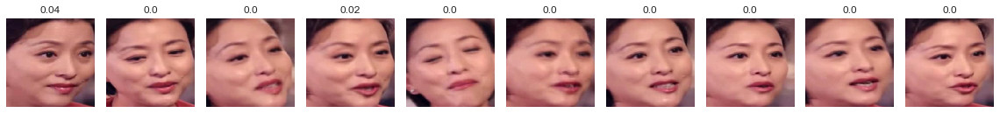

[Extracted 10 faces for file id9_0000.mp4]
Label: real
Fake prob: 0.05929134413599968


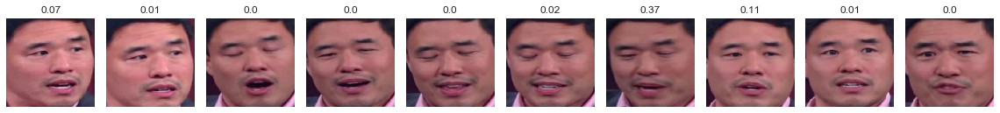

[Extracted 10 faces for file id9_0006.mp4]
Label: real
Fake prob: 0.03203800320625305


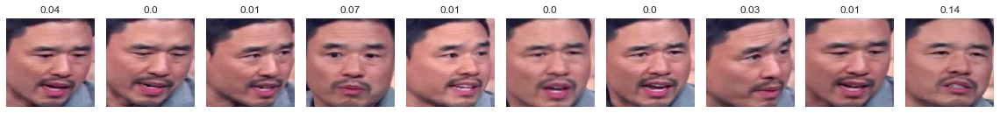

[Extracted 10 faces for file id9_0008.mp4]
Label: real
Fake prob: 0.032045554369688034


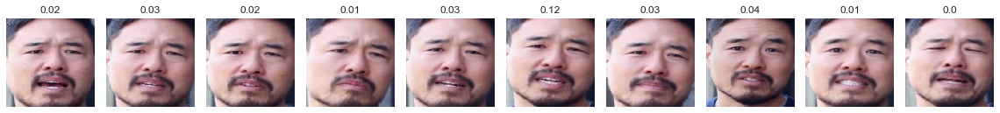

[Extracted 10 faces for file id9_0009.mp4]
Label: real
Fake prob: 0.10237079113721848


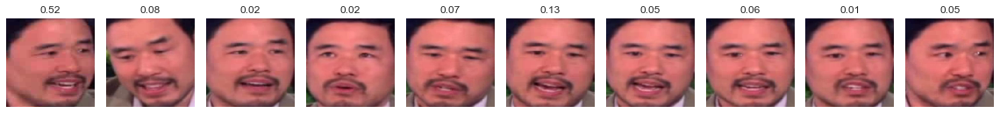

Thresholds
[1.99178976e+00 9.91789758e-01 7.28014410e-01 7.03978777e-01
 5.74914455e-01 5.68199217e-01 4.76931483e-01 4.72883463e-01
 4.36161518e-01 4.12838846e-01 3.37426782e-01 3.30774754e-01
 3.21119398e-01 2.66757548e-01 2.54575282e-01 1.04954328e-04]
Length labels: 168
Length predictions: 168
Optimal threshold = 0.3374267816543579
Confusion matrix for threshold None
[[82  2]
 [13 71]]
[Acc: 0.911]
[Precision: 0.973]
[Recall: 0.845]
[F1: 0.904]


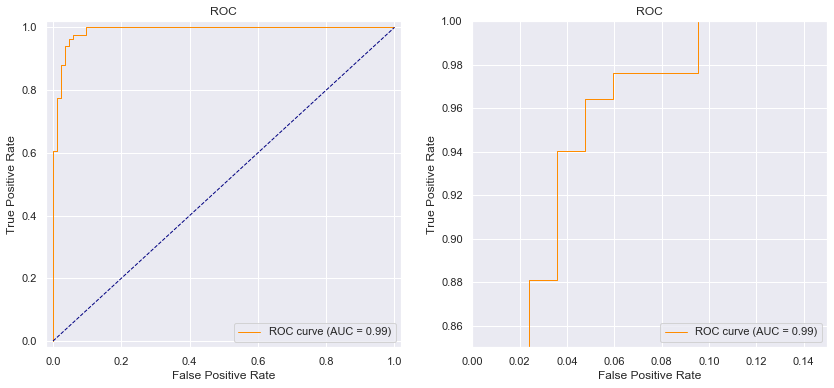

In [16]:
predict_files(model=pretrained_model,
              path=file_path,
              n_frames=n_frames,
              device=device,
              agg='mean',
              temporal=temporal,
              plot_ims=True,
              threshold=None,
              verbose=True,
              log_metrics=False)


